# MANUAL NET ARCHITECTURE

In [1]:
import tensorflow
import tensorflow as tf
print(tf.__version__)

import os 
import glob
from PIL import Image
import matplotlib.pyplot as plt

from tensorflow.keras.models import Sequential

from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Activation


2.15.0


In [2]:
CRACK = 'Dataset/CRACK'
GAP = 'Dataset/GAP'
RISSBI = 'Dataset/RISSBI'
DEEPCRACK = 'Dataset/DEEPCRACK'

In [3]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]
    
    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(3, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    
    plt.tight_layout()
    
def image_details_print(data,path):
    print('======== Images in: ', path)
    for key,values in data.items():
        print(key,':\t', values)


def images_details(path):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    data={}
    data['Images_count']=len(files)
    data['Min_width']=10**100
    data['Max_width']=0
    data['Min_height']=10**100
    data['Max_height']=0
    
    for f in files:
        img=Image.open(f)
        width,height=img.size
        data['Min_width']=min(width,data['Min_width'])
        data['Max_width']=max(width, data['Max_width'])
        data['Min_height']=min(height, data['Min_height'])
        data['Max_height']=max(height, data['Max_height'])
        
    image_details_print(data,path)


TRAINING DATA FOR CRACK:

======== Images in:  Dataset/CRACK
Images_count :	 219
Min_width :	 448
Max_width :	 448
Min_height :	 448
Max_height :	 448



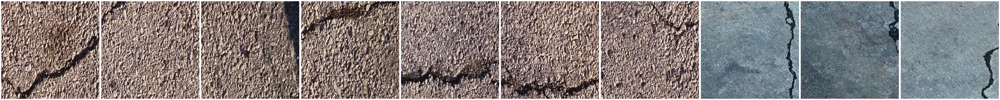

In [4]:
print("")
print("TRAINING DATA FOR CRACK:")
print("")
images_details(CRACK)
print("")
plot_images(CRACK, 10) 


TRAINING DATA FOR GAP:

======== Images in:  Dataset/GAP
Images_count :	 220
Min_width :	 448
Max_width :	 448
Min_height :	 448
Max_height :	 448



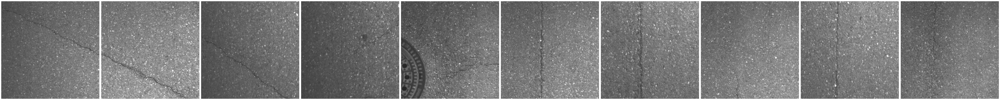

In [5]:
print("")
print("TRAINING DATA FOR GAP:")
print("")
images_details(GAP)
print("")
plot_images(GAP, 10)


TRAINING DATA FOR RISSBI:

======== Images in:  Dataset/RISSBI
Images_count :	 220
Min_width :	 448
Max_width :	 448
Min_height :	 448
Max_height :	 448



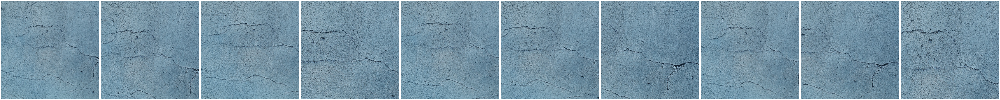

In [6]:
print("")
print("TRAINING DATA FOR RISSBI:")
print("")
images_details(RISSBI)
print("")
plot_images(RISSBI, 10)


TRAINING DATA FOR DEEPCRACK:

======== Images in:  Dataset/DEEPCRACK
Images_count :	 215
Min_width :	 448
Max_width :	 448
Min_height :	 448
Max_height :	 448



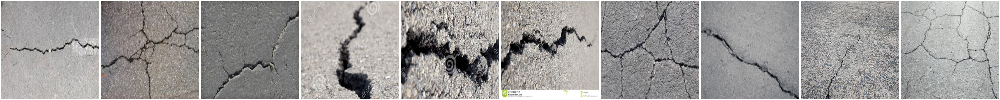

In [7]:
print("")
print("TRAINING DATA FOR DEEPCRACK:")
print("")
images_details(DEEPCRACK)
print("")
plot_images(DEEPCRACK, 10)

In [8]:
# Define the path to your dataset directory
dataset_dir = 'Dataset'

# Set the batch size and number of classes
batch_size = 64
num_classes = 6

In [9]:
# Create an ImageDataGenerator for data augmentation and preprocessing

from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    validation_split=0.2)

In [10]:
# Load and preprocess the dataset using the ImageDataGenerator

train_generator = datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training')

Found 1051 images belonging to 6 classes.


In [11]:
validation_generator = datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation')


Found 261 images belonging to 6 classes.


In [15]:
MODEL=Sequential()
MODEL.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
MODEL.add(MaxPooling2D(pool_size=(2,2)))
MODEL.add(Flatten())
MODEL.add(Dense(6, activation='softmax'))
MODEL.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])

In [16]:
epochs = 10

In [17]:
history = MODEL.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=epochs # Add the callbacks here
)

Epoch 1/10
17/17 [==============================] - 44s 2s/step - loss: 20.2537 - accuracy: 0.3083 - val_loss: 1.9025 - val_accuracy: 0.4023
Epoch 2/10
17/17 [==============================] - 28s 2s/step - loss: 2.2310 - accuracy: 0.4367 - val_loss: 2.1542 - val_accuracy: 0.2529
Epoch 3/10
17/17 [==============================] - 29s 2s/step - loss: 1.2527 - accuracy: 0.5461 - val_loss: 1.6748 - val_accuracy: 0.4176
Epoch 4/10
17/17 [==============================] - 27s 2s/step - loss: 1.1335 - accuracy: 0.6175 - val_loss: 1.9914 - val_accuracy: 0.2759
Epoch 5/10
17/17 [==============================] - 28s 2s/step - loss: 1.2179 - accuracy: 0.5833 - val_loss: 1.1461 - val_accuracy: 0.5249
Epoch 6/10
17/17 [==============================] - 28s 2s/step - loss: 1.1224 - accuracy: 0.5890 - val_loss: 1.3222 - val_accuracy: 0.6322
Epoch 7/10
17/17 [==============================] - 27s 2s/step - loss: 0.9516 - accuracy: 0.6794 - val_loss: 1.3978 - val_accuracy: 0.5326
Epoch 8/10
17/17 [=

In [ ]:
import matplotlib.pyplot as plt

def graph():
    #Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

graph()

In [ ]:
import matplotlib.pyplot as plt

def graph():
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
graph()